<a href="https://colab.research.google.com/github/laagrrluv/batch_indexing_machine/blob/main/Unsupervised_learning_for_random_parts.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Structuring assorted random parts using siamese networks and triplet loss


This is the latest breakthrough in my quest for finding ways to automatically structure and classify random parts, a tech that can be used to build digital circular economy solutions. If we can effectively document unused parts, it's easier to find new uses for them.

Key features:

*   Works with many different types of parts: Legobricks, metal scrap, whatever really...
*   Works in many different types of machines and scenarios, as long as there is some kind of shaking going on, the algorithm should be able to identify individual parts.
*   Facilitates a modern approach to transfer learning. If i had 1000 movies similar to the one below, but with other batches of random parts, I could do a pre-training on the entire dataset and then fine-tune on one batch.

The data used to train the model in this document is the 5 minute video shown below. At 24 fps that equals rougly 7200 images.

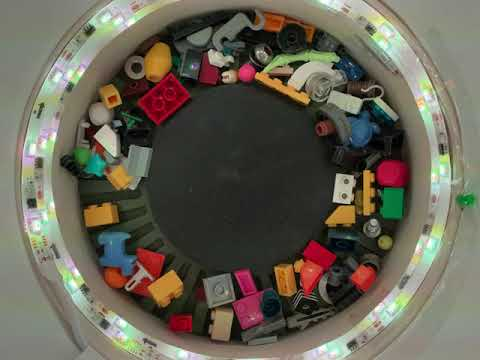

In [ ]:
from IPython.display import YouTubeVideo
YouTubeVideo("NBq8v40ebHE", width=400)

The learning algorithm works by pairing two frames that are roughly from the same time in the movie, not separated by more than 8 frames / 0.33 seconds.

The images are then split into patches of 64x64 pixels, and the areas that doesn't contain any parts are disregarded, leaving this donut shape of random parts.

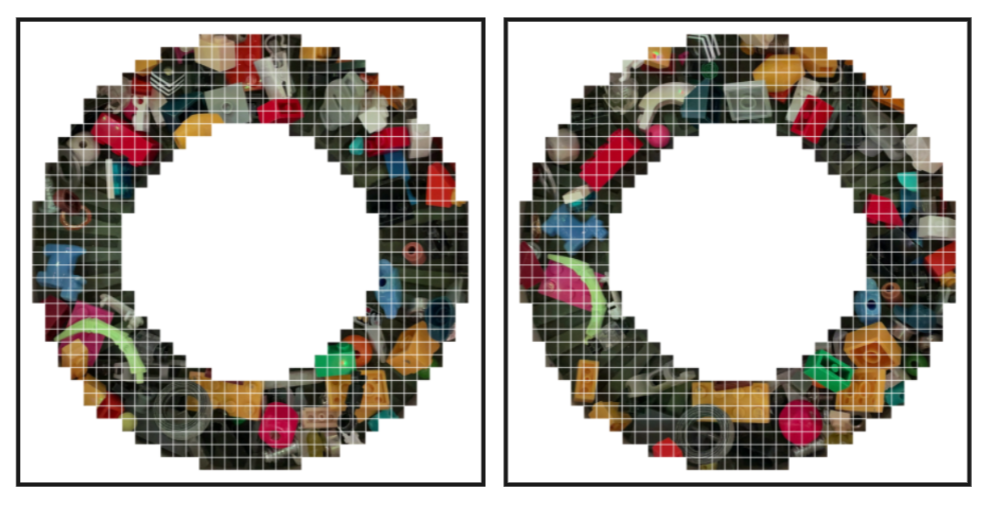

The patches are run through a standard CNN that outputs a l2 normalized feature vector. The goal of the triplet loss is that the feature vector should be similar for images of the same part (anchor to positive), and not similar for images of different parts (anchor to negative). 

For each patch in the left image (anchor), the patch with the most similar feature vector in close proximity to the anchor, but in the right image, is our positive example. The most similar, not in proximity, is our negative anchor.

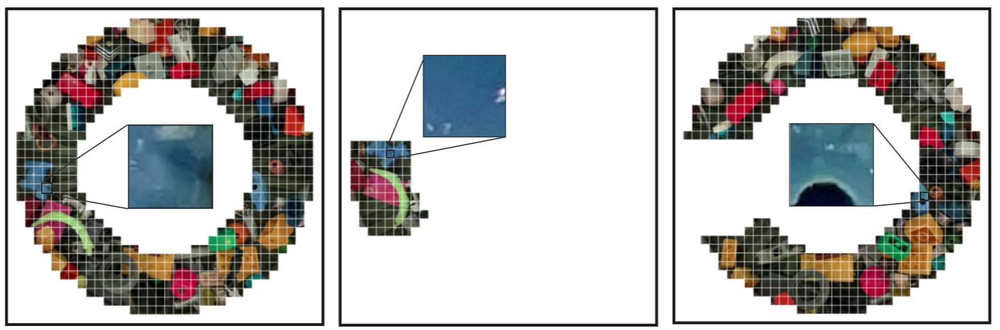


This is a custom adaption of siamese networks with triplet loss learning, as the original is used with labeled examples. The best known usecase for siamese networks are for face recognition, where the model is optimized to provide similar results for different images of the same person.

In [3]:
#cloning my github, it's under construction...
#!rm -r batch_indexing_machine
!git clone https://github.com/laagrrluv/batch_indexing_machine.git

Cloning into 'batch_indexing_machine'...
remote: Enumerating objects: 25, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 25 (delta 7), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (25/25), 49.99 MiB | 8.46 MiB/s, done.


In [1]:
import numpy as np
import cv2
import tensorflow as tf
import os
from google.colab.patches import cv2_imshow

from batch_indexing_machine import indexer

In [2]:
tfrecords_dir='tfrecs/'
image_size=2304
patch_size=64
shuffle_buffer=8

In [ ]:
# Download the .mov file

"""
!gsutil -m cp -r gs://lego-indexing-machine/movs/2023-02-23* /content/
"""

In [ ]:
# This function turns our movie into a format more easily digestible by the training process (.tfrecords)
"""
indexer.mov2tfrecs(path='/content/2023-02-23 20-05-36 RTEY 3200x2400 24fps.mov',
                   tfrecs_dir=tfrecords_dir,
                   center=(1200,1600), 
                   crop_size=image_size)

"""

In [ ]:
# upload dataset to cloud storage
"""

from google.colab import auth
auth.authenticate_user()
!gsutil -m cp -r /content/tfrecs/* gs://lego-indexing-machine/continous/
"""

In [ ]:
#if you don't want to wait for this, the dataset can be downloaded directly here

if not os.path.exists(tfrecords_dir):
  os.makedirs(tfrecords_dir)

!gsutil -m cp -r gs://lego-indexing-machine/continous/* /content/tfrecs/

In [ ]:
# Shuffling the tfrecs files, the more shuffled the better (i think)

tfrecs=os.listdir(tfrecords_dir)
tfrecs=[tfrecords_dir+a for a in tfrecs if 'train' in a]
tfrecs=np.sort(tfrecs)
tfrecs_ds=tf.data.Dataset.from_tensor_slices(tfrecs).shuffle(100)

for d in tfrecs_ds.take(5):
  print(d)

tf.Tensor(b'tfrecs/train_0048.tfrec', shape=(), dtype=string)
tf.Tensor(b'tfrecs/train_0054.tfrec', shape=(), dtype=string)
tf.Tensor(b'tfrecs/train_0067.tfrec', shape=(), dtype=string)
tf.Tensor(b'tfrecs/train_0086.tfrec', shape=(), dtype=string)
tf.Tensor(b'tfrecs/train_0006.tfrec', shape=(), dtype=string)


In [ ]:
# Generating our pairs. Had to build my own batch_shuffle function since tf.data.Dataset.shuffle() generate erratic results

def batch_shuffle(x,y):
  r=tf.random.shuffle(tf.range(8))
  return tf.gather(x,r),tf.gather(y,r)

ds_pairs=tf.data.TFRecordDataset(tfrecs_ds).map(indexer.parse_tfrecord_fn).batch(8, drop_remainder=True).map(batch_shuffle).unbatch().batch(2).shuffle(200)
for d in ds_pairs.take(10):
  #print(d[0].shape)
  print(d[1])

tf.Tensor([2690 2691], shape=(2,), dtype=int64)
tf.Tensor([47 46], shape=(2,), dtype=int64)
tf.Tensor([3902 3903], shape=(2,), dtype=int64)
tf.Tensor([5373 5372], shape=(2,), dtype=int64)
tf.Tensor([24 30], shape=(2,), dtype=int64)
tf.Tensor([3850 3848], shape=(2,), dtype=int64)
tf.Tensor([3884 3881], shape=(2,), dtype=int64)
tf.Tensor([50 53], shape=(2,), dtype=int64)
tf.Tensor([3841 3842], shape=(2,), dtype=int64)
tf.Tensor([2710 2704], shape=(2,), dtype=int64)


In [ ]:
# Generate the donut shape

def donut(patch_size, img_size, lower_limit=0.55, upper_limit=0.95):
  
  gridsize=img_size//2//patch_size

  #create a grid of patch coordinates relative to center of image, and calculate distance from center
  coords=np.array([[(i+0.5,j+0.5) for i in range(-gridsize,gridsize)] for j in range(-gridsize,gridsize)])
  norm=np.linalg.norm(coords,axis=2)
  
  #we are only interested in the "donut" where the parts are, anything close to the center and far from the center is disregarded
  keep_bool=((norm>(gridsize*lower_limit))*(norm<(gridsize*upper_limit)))
  keep=tf.constant(np.where(keep_bool.flatten())[0],dtype=tf.int32)

  return coords,keep,keep_bool

coords,keep,keep_bool=donut(patch_size,image_size)
n_patches=len(keep)

In [ ]:
#final dataset generation with the patches

def patch(x,y):
  patches=indexer.Patches(patch_size)(x)
  x=tf.gather(patches,indices=keep)
  return x, tf.repeat(y,keep.shape[0])
  

ds_train=ds_pairs.unbatch().batch(1).map(patch).unbatch().batch(n_patches*2)

for d in ds_train.take(1):
  print(d[0].shape)

(1208, 64, 64, 3)


In [ ]:
# The mask define what is close proximity, and what is not

def create_mask(coords_valid, limit=6):

  diff=coords_valid[np.newaxis,:,:]-coords_valid[:,np.newaxis,:]
  norm=np.linalg.norm(diff,axis=2)
  mask=norm<limit

  return tf.constant(mask,dtype=tf.float32)
  
mask=create_mask(coords.reshape(-1,2)[keep.numpy()])
mask.shape

TensorShape([604, 604])

In [ ]:
# the custom loss algorithm!

def custom_triple_loss(y_true,y_pred):

  margin=1

  y_pred=tf.cast(y_pred,mask.dtype)

  a=tf.expand_dims(y_pred[n_patches:],axis=0)
  b=tf.expand_dims(y_pred[:n_patches],axis=1)
  distance=tf.linalg.norm(a-b,axis=2)
  min0=tf.reduce_min(distance * (1+mask*999),axis=0)    #(1+matrix*999) is big when mask==1 ---> reduce_min will be from an instance where mask==0
  min1=tf.reduce_min(distance * (1000-mask*999),axis=0) #and vice versa

  return  tf.reduce_mean(tf.math.square(min1) + tf.math.square(tf.math.maximum(margin - min0, 0.0)))

custom_triple_loss(0,np.random.random((604*2,1280)))

<tf.Tensor: shape=(), dtype=float32, numpy=198.08882>

In [ ]:
img_size=patch_size

inp=tf.keras.Input((img_size,img_size,3),name="main_input")

cnn=tf.keras.applications.EfficientNetB0(include_top=False,input_shape=(img_size,img_size,3),pooling='avg')(inp)

l2norm=tf.keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))(cnn) #normalize featurevector along 1st axis, needed for the loss function to work (I think)

model=tf.keras.Model(inp,l2norm)

model.summary()

16705208/16705208 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 main_input (InputLayer)     [(None, 64, 64, 3)]       0         
                                                                 
 efficientnetb0 (Functional)  (None, 1280)             4049571   
                                                                 
 lambda (Lambda)             (None, 1280)              0         
                                                                 
Total params: 4,049,571
Trainable params: 4,007,548
Non-trainable params: 42,023
_________________________________________________________________


In [ ]:
model.compile(loss=custom_triple_loss, optimizer="adam")

In [ ]:
model.fit(ds_train,epochs=5)

Epoch 1/5
3624/3624 [==============================] - 719s 185ms/step - loss: 0.4471
Epoch 2/5
3624/3624 [==============================] - 673s 185ms/step - loss: 0.3797
Epoch 3/5
3624/3624 [==============================] - 674s 185ms/step - loss: 0.3627
Epoch 4/5
3624/3624 [==============================] - 674s 185ms/step - loss: 0.3456
Epoch 5/5
3624/3624 [==============================] - 674s 185ms/step - loss: 0.3368


In [ ]:
ds_index=tf.data.TFRecordDataset(tfrecs).map(indexer.parse_tfrecord_fn).batch(1).map(patch)

In [ ]:
pred=model.predict(ds_index.take(200))
pred.shape

200/200 [==============================] - 14s 57ms/step


In [ ]:
pred.shape

(120800, 1280)

In [ ]:
imgs=np.concatenate([d[0] for d in ds_index.take(200)])
imgs.shape

(120800, 64, 64, 3)

In [ ]:
"""

np.save('pred',pred)
np.save('imgs',imgs)
model.save_weights('weights.h5')

from google.colab import auth
auth.authenticate_user()
!gsutil -m cp -r /content/pred.npy gs://lego-indexing-machine/pred0226.npy
!gsutil -m cp -r /content/imgs.npy gs://lego-indexing-machine/imgs0226.npy
!gsutil -m cp -r /content/weights.h5 gs://lego-indexing-machine/weights226.h5

"""

# Evaluation

doing a simple clustering algorithm on the feature vectors to see if it will pick out individual parts

In [4]:
!gsutil -m cp -r gs://lego-indexing-machine/pred0226.npy /content/pred.npy
!gsutil -m cp -r gs://lego-indexing-machine/imgs0226.npy /content/imgs.npy
!gsutil -m cp -r gs://lego-indexing-machine/weights226.h5 /content/weights.h5

Copying gs://lego-indexing-machine/pred0226.npy...
| [1/1 files][589.8 MiB/589.8 MiB] 100% Done                                    
Operation completed over 1 objects/589.8 MiB.                                    
Copying gs://lego-indexing-machine/imgs0226.npy...
/ [1/1 files][  1.4 GiB/  1.4 GiB] 100% Done  63.4 MiB/s ETA 00:00:00           
Operation completed over 1 objects/1.4 GiB.                                      
Copying gs://lego-indexing-machine/weights226.h5...
/ [1/1 files][ 15.7 MiB/ 15.7 MiB] 100% Done                                    
Operation completed over 1 objects/15.7 MiB.                                     


In [8]:
pred=np.load('pred.npy')
imgs=np.load('imgs.npy')

In [9]:
imgs=np.flip(imgs,axis=3) #needed because images are created in BGR instead of RGB

In [4]:
#running kmeans on the feature vectors (pred) clusters images that the model concider similar


from sklearn.cluster import KMeans

n_clusters=100
kmeans = KMeans(n_clusters=n_clusters).fit(pred[np.random.randint(len(pred),size=5000)])

clusters=kmeans.predict(pred)
clusters.shape


(120800,)

0


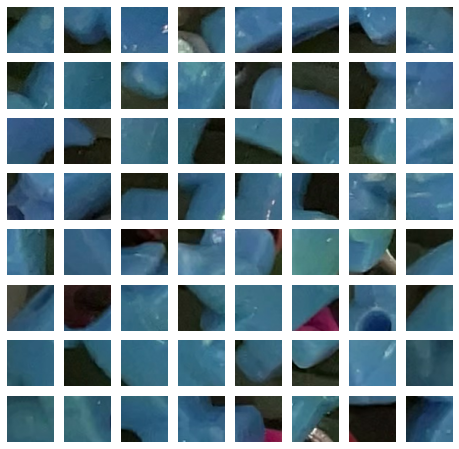

1


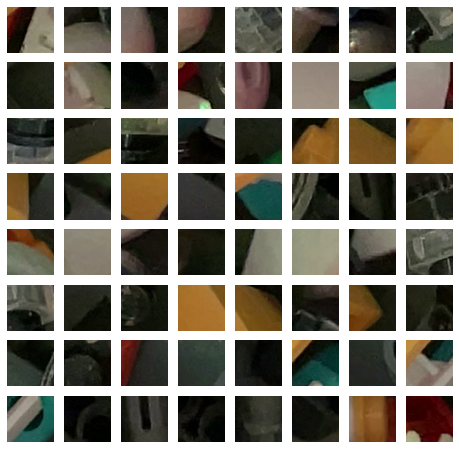

2


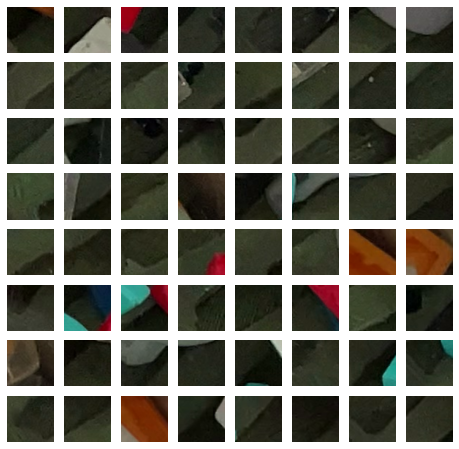

3


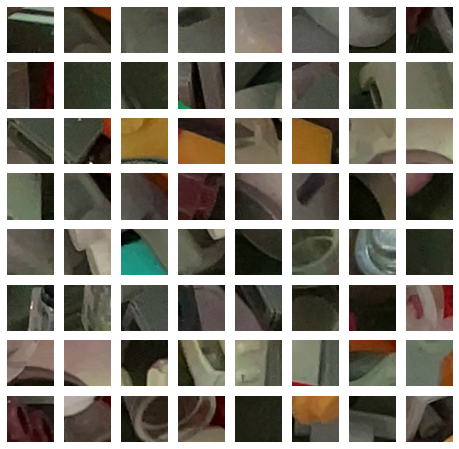

4


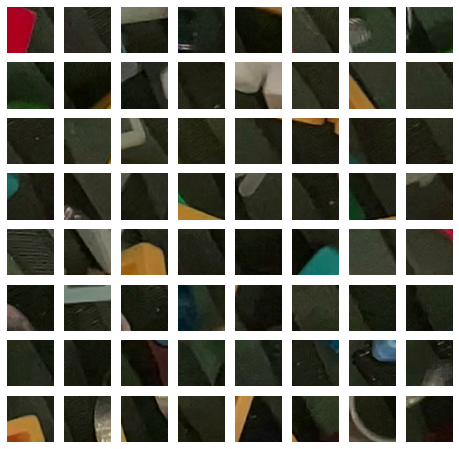

5


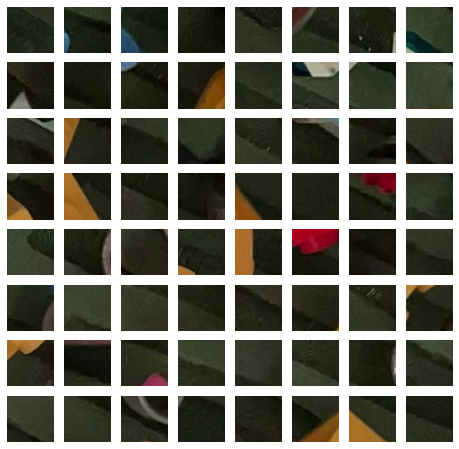

6


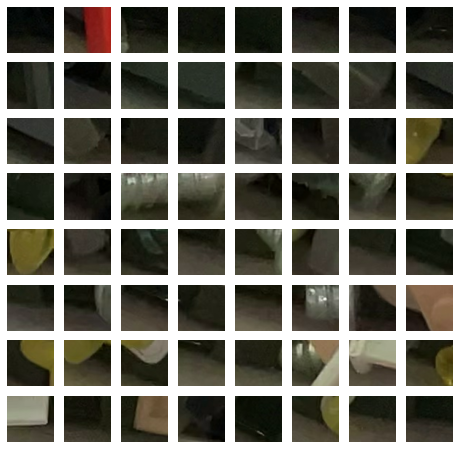

7


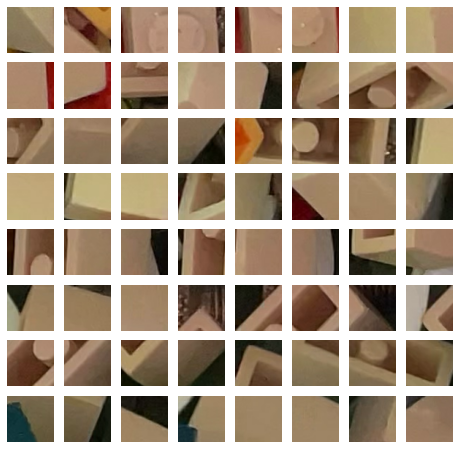

8


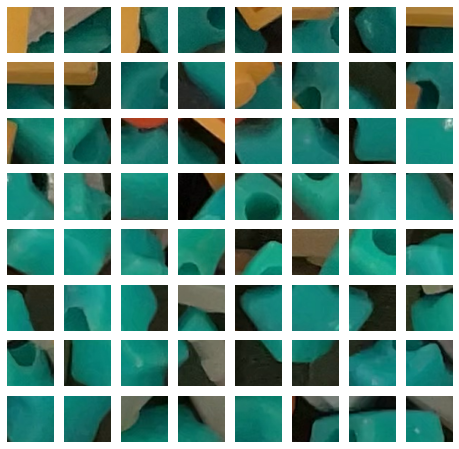

9


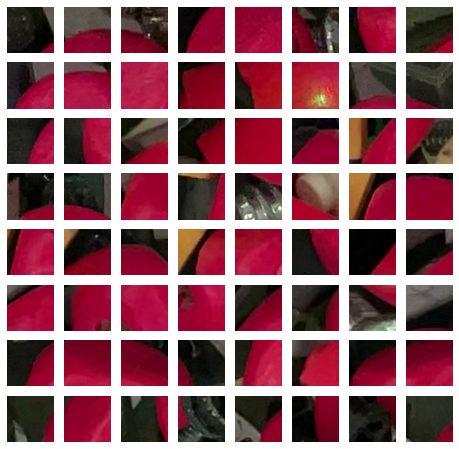

10


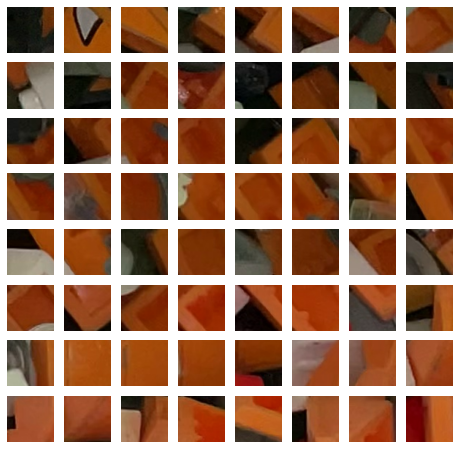

11


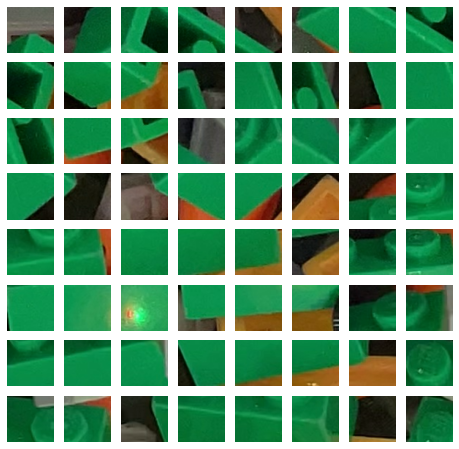

12


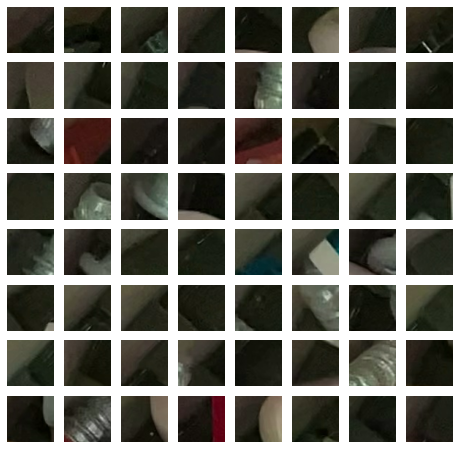

13


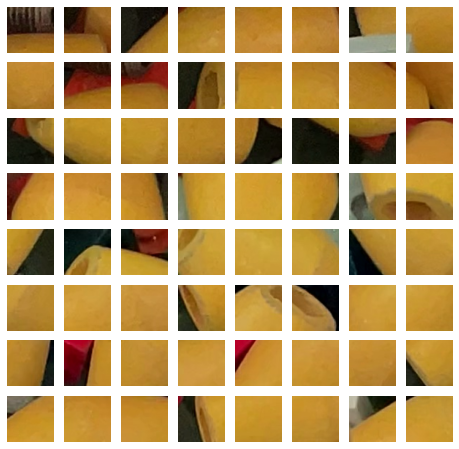

14


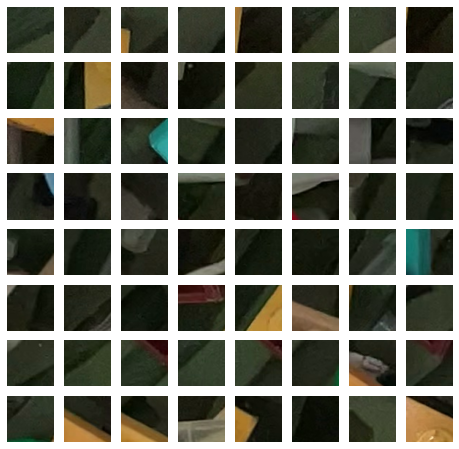

15


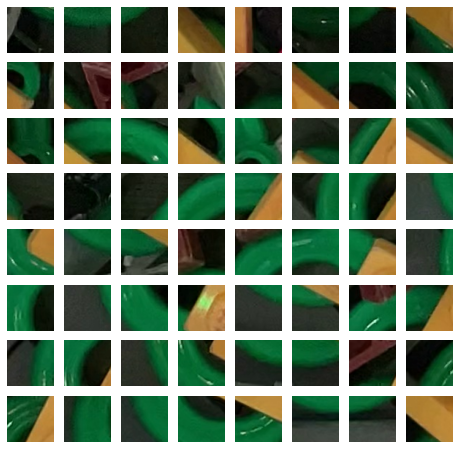

16


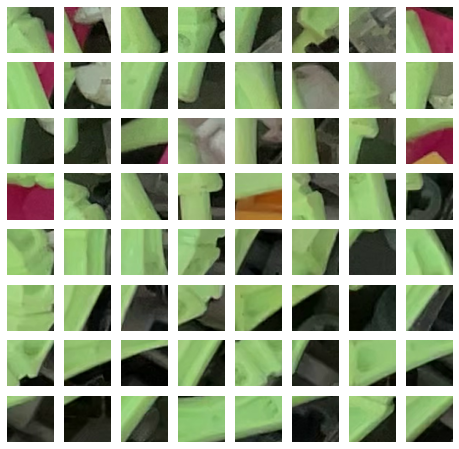

17


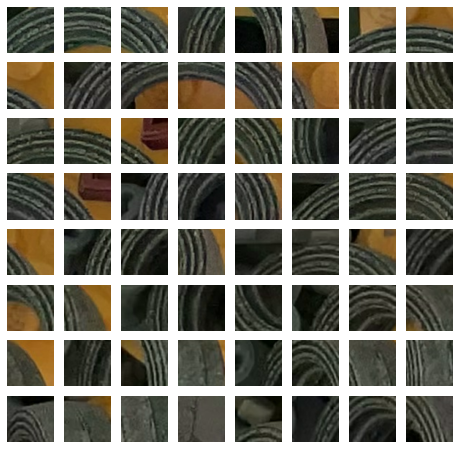

18


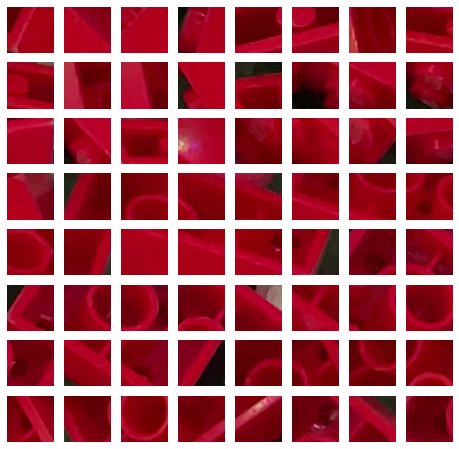

19


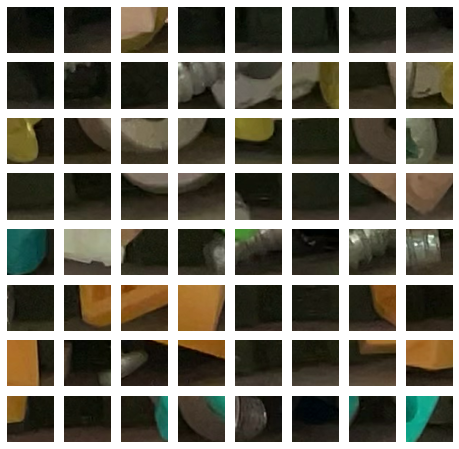

20


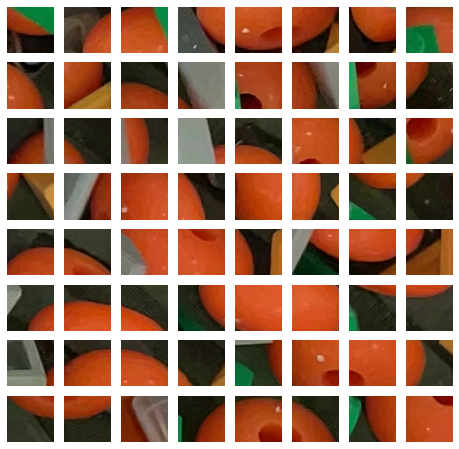

21


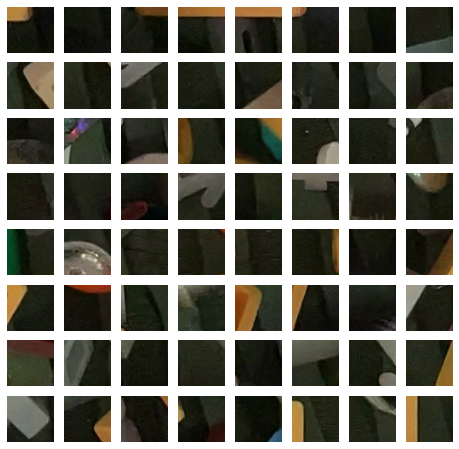

22


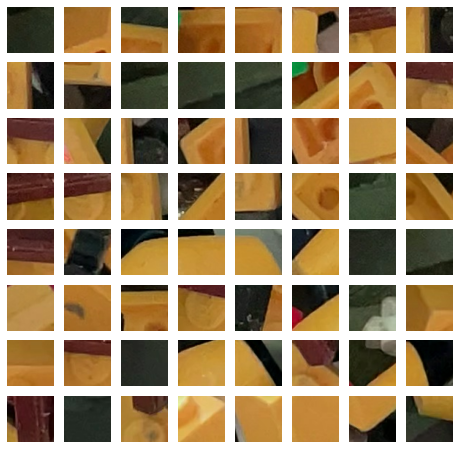

23


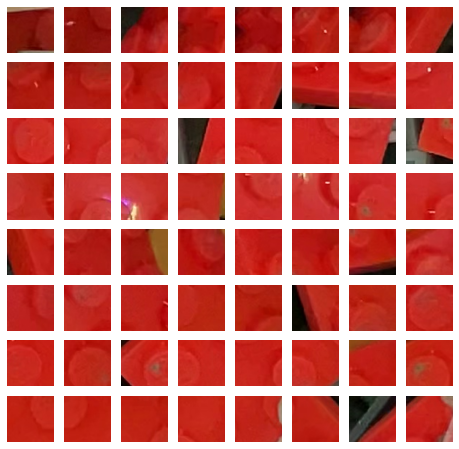

24


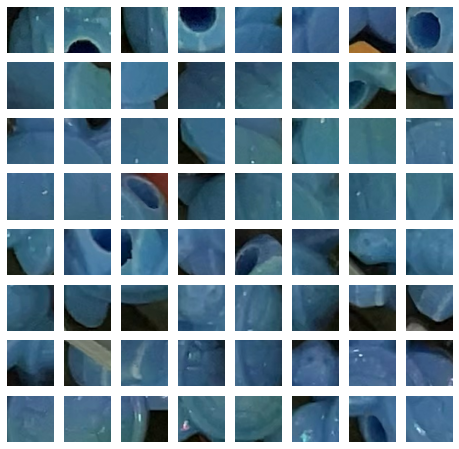

25


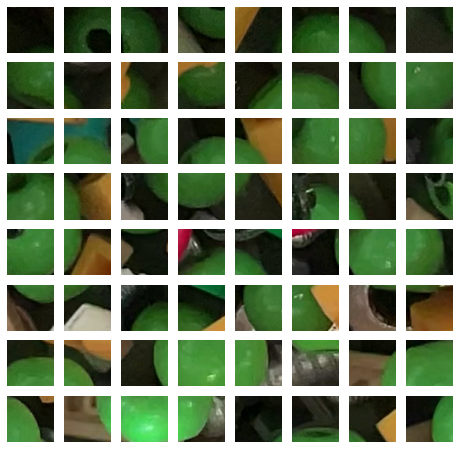

26


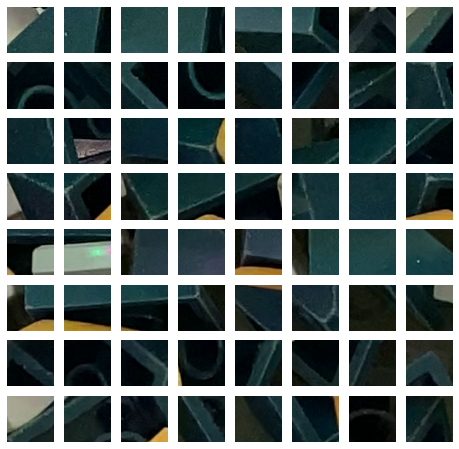

27


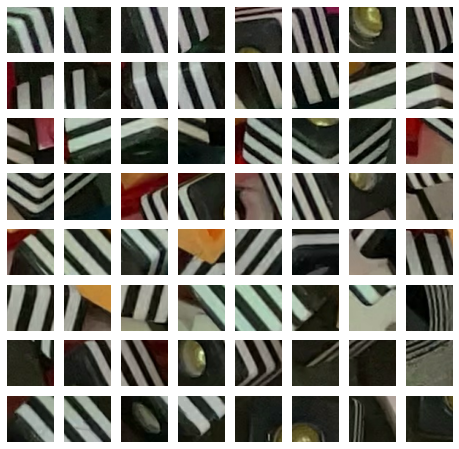

28


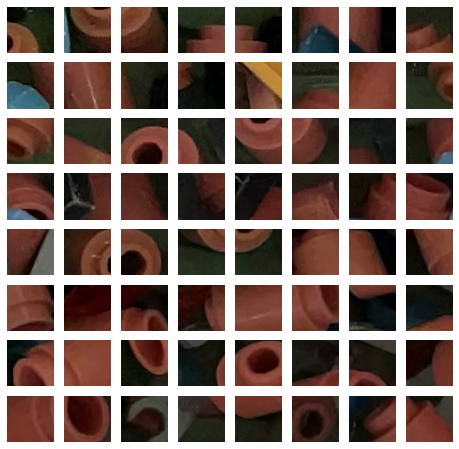

29


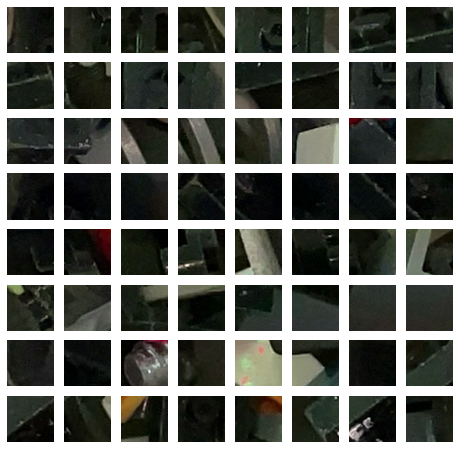

30


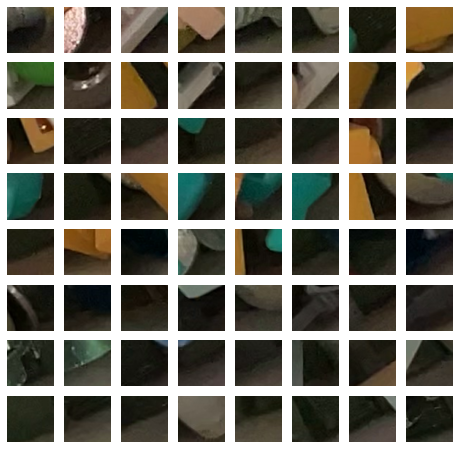

31


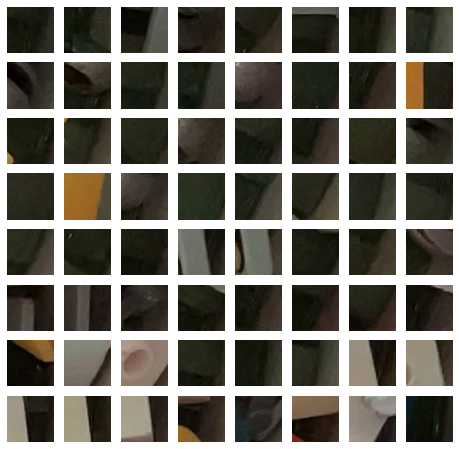

32


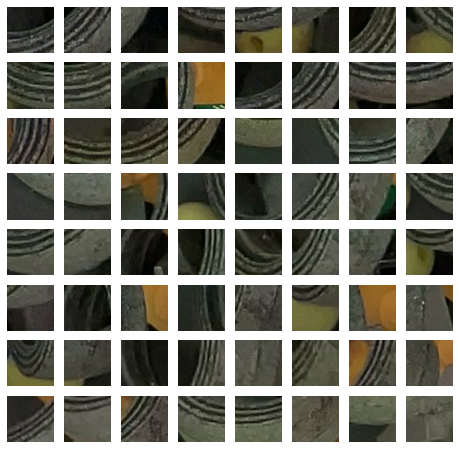

33


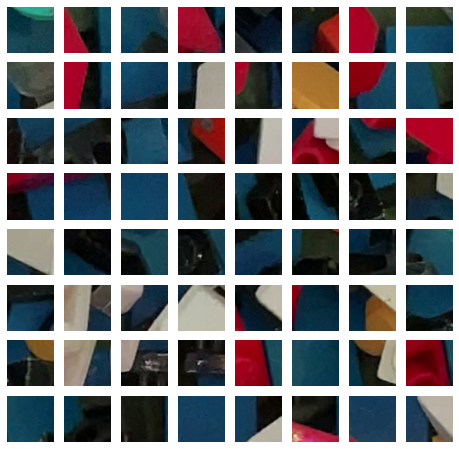

34


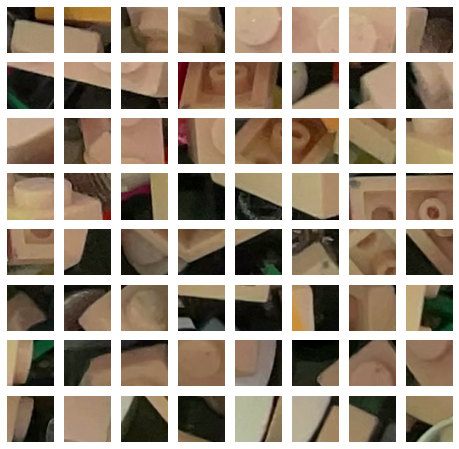

35


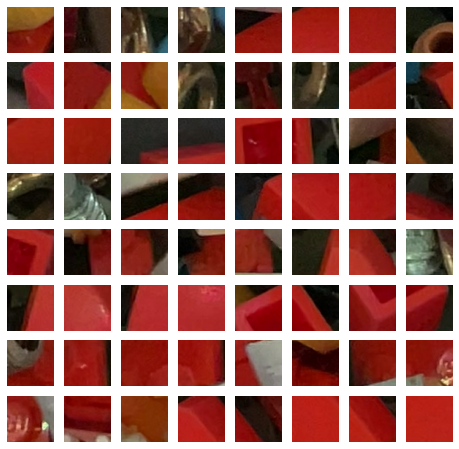

36


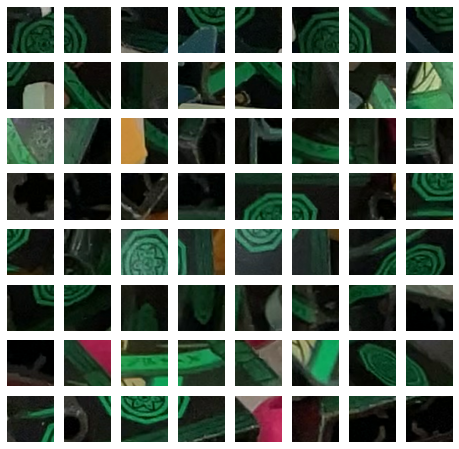

37


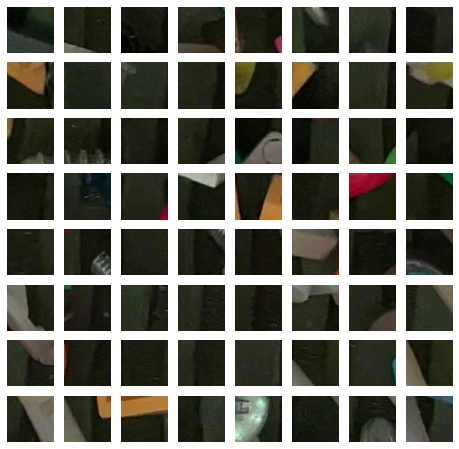

38


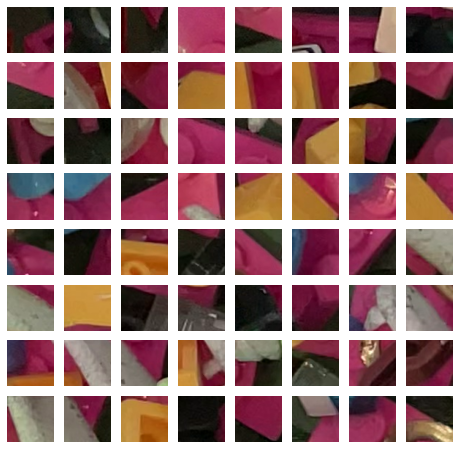

39


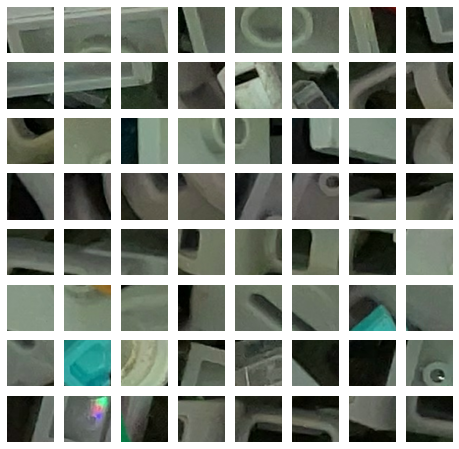

40


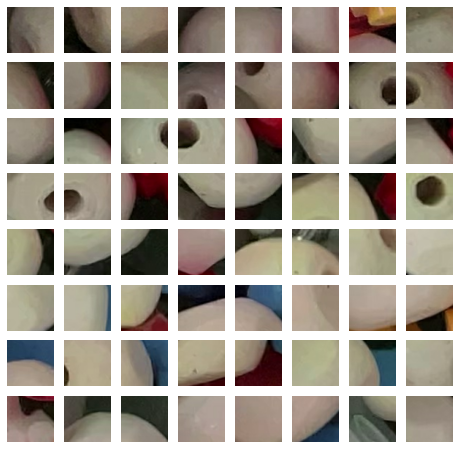

41


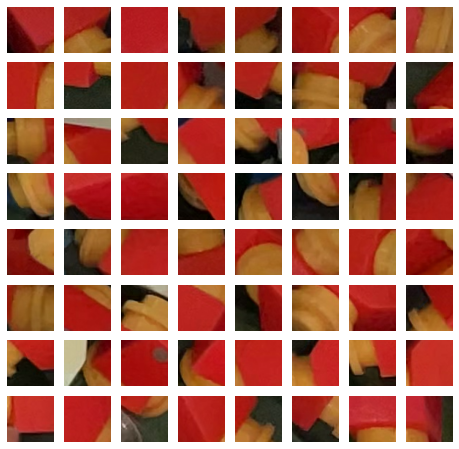

42


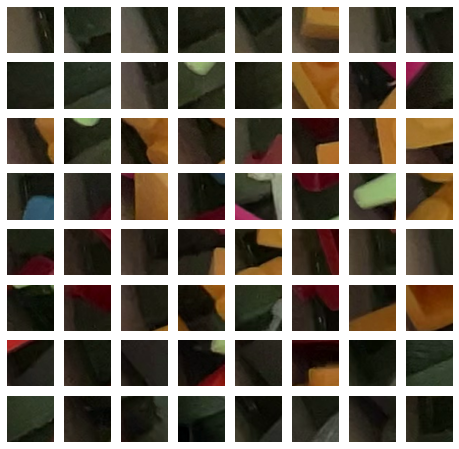

43


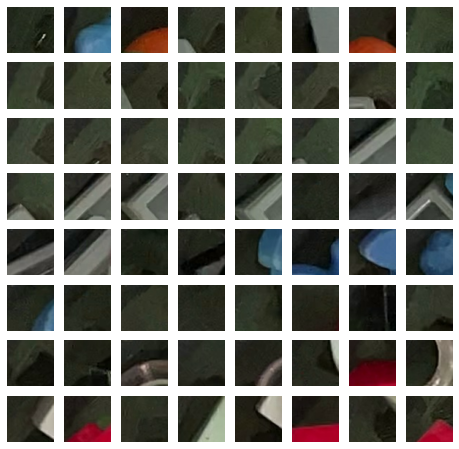

44


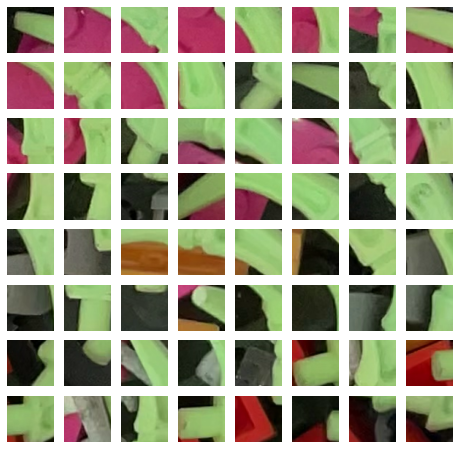

45


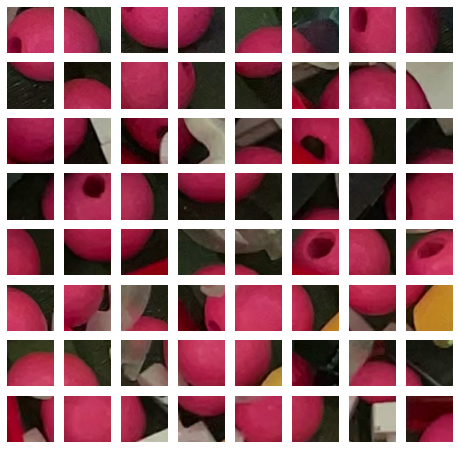

46


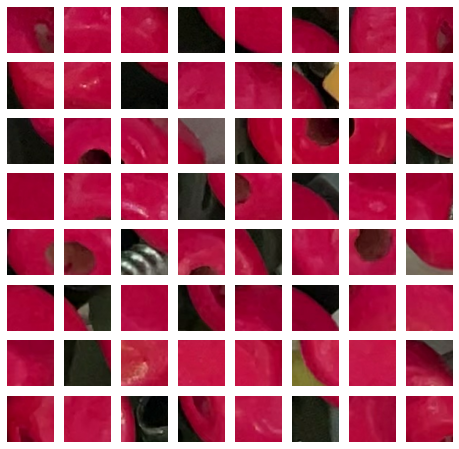

47


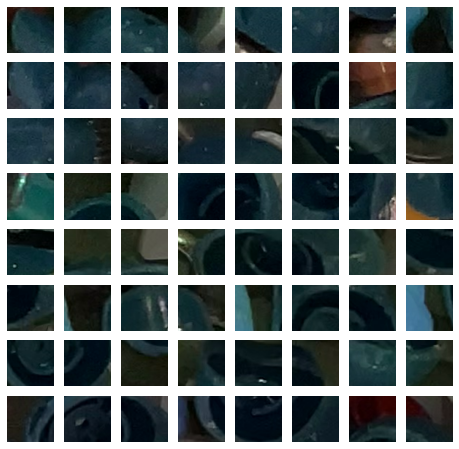

48


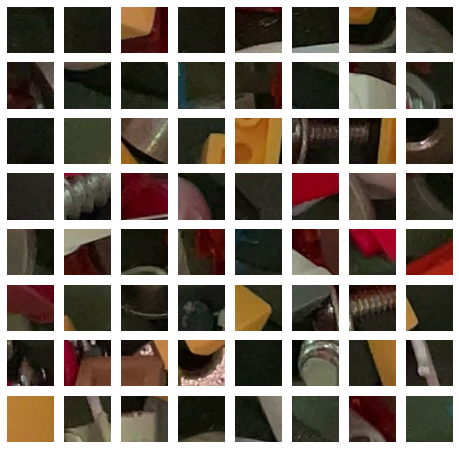

49


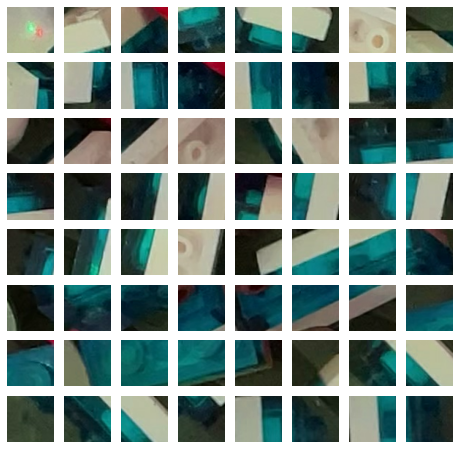

50


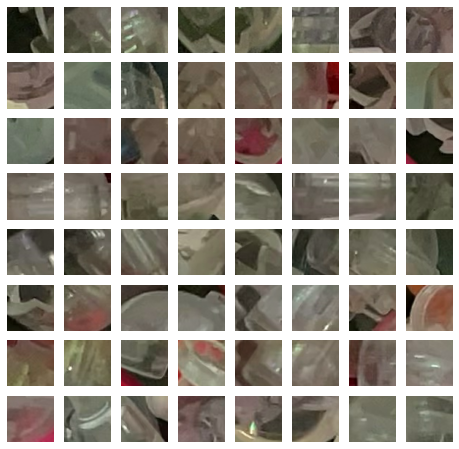

51


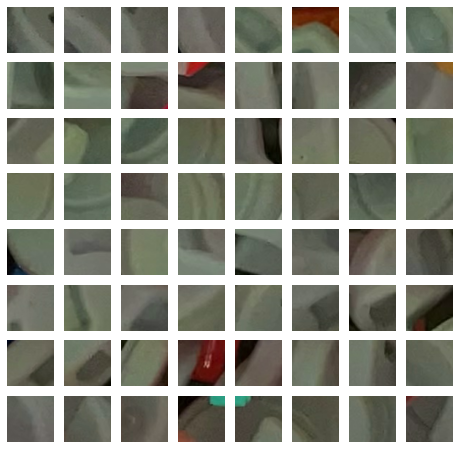

52


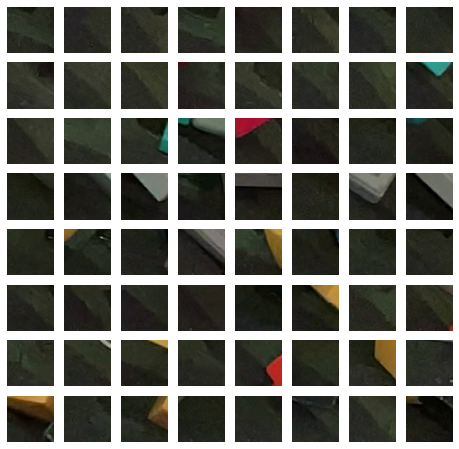

53


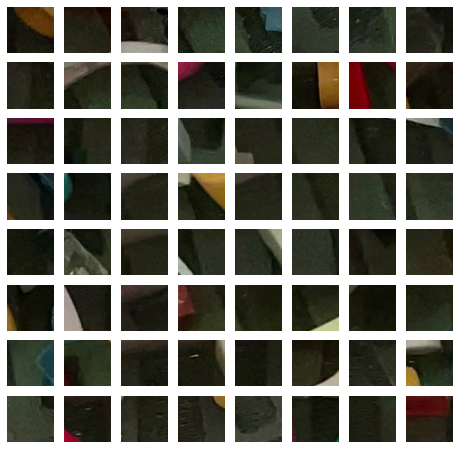

54


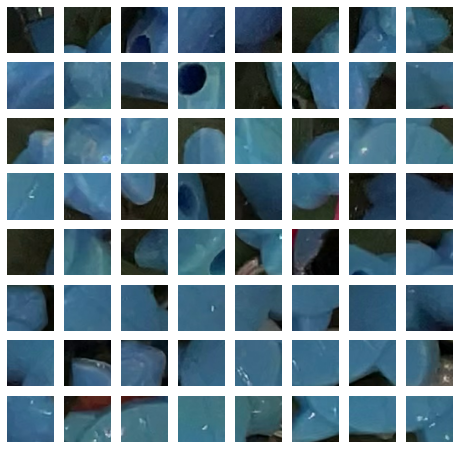

55


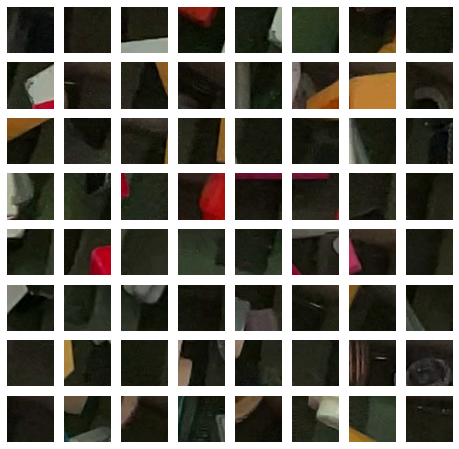

56


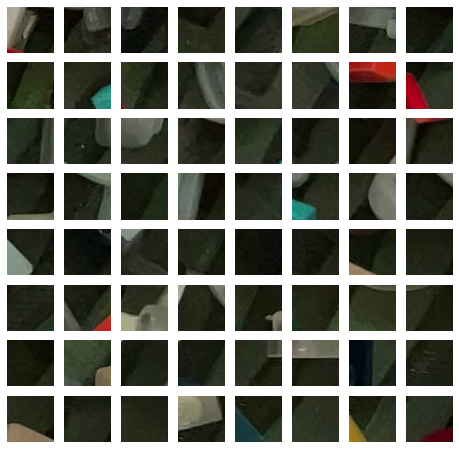

57


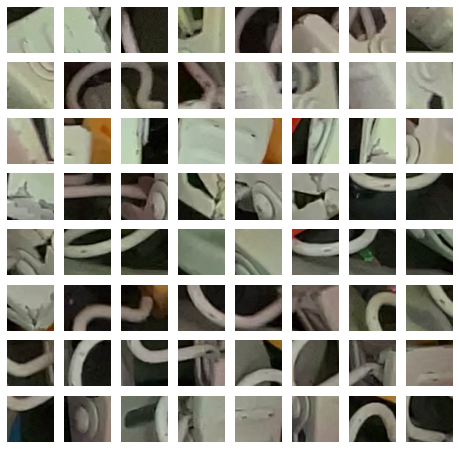

58


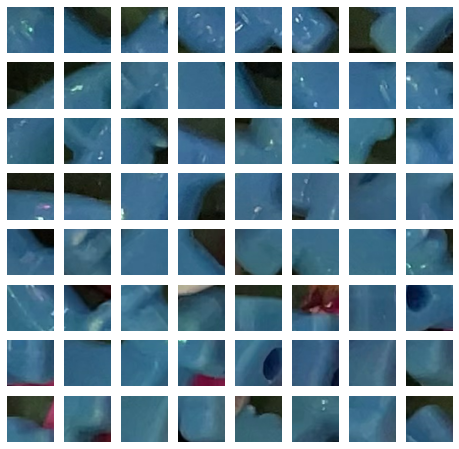

59


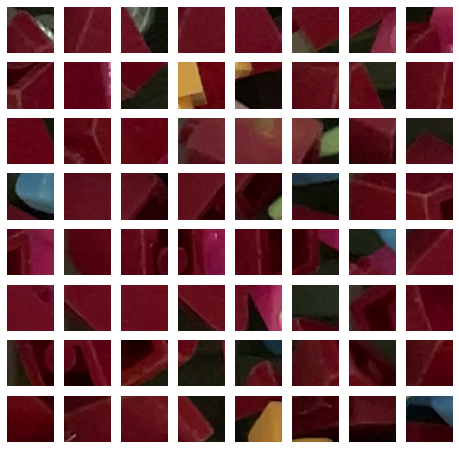

60


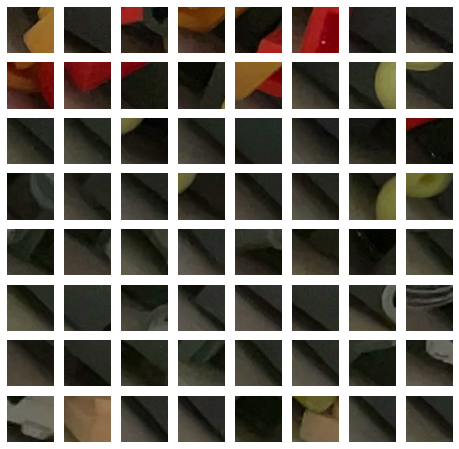

61


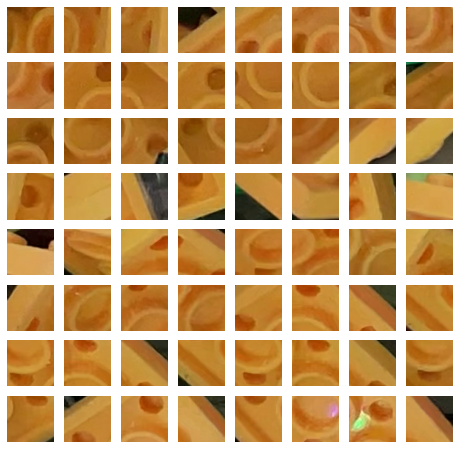

62


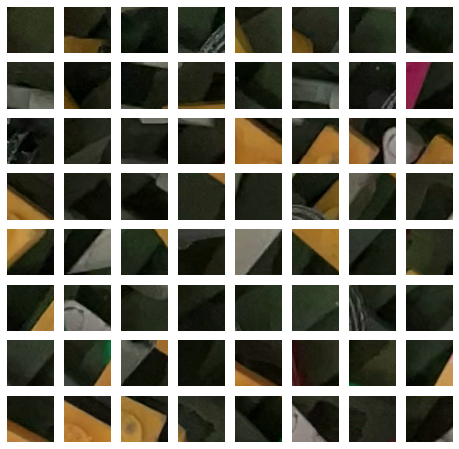

63


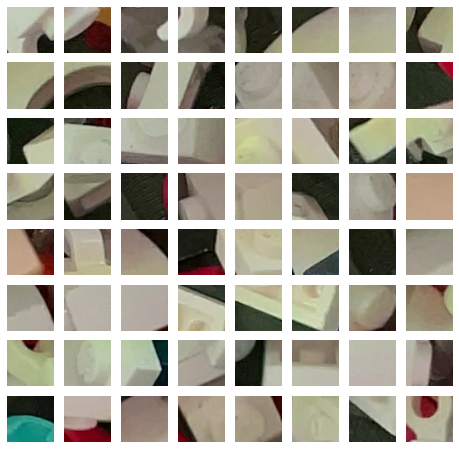

64


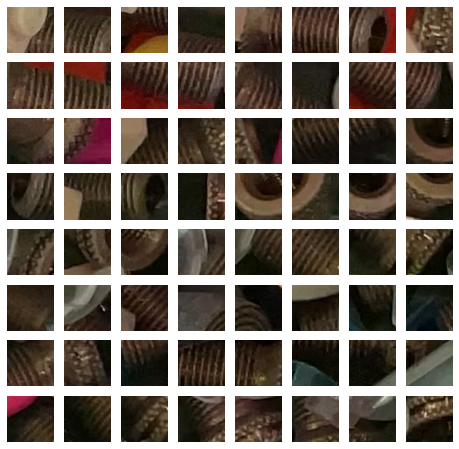

65


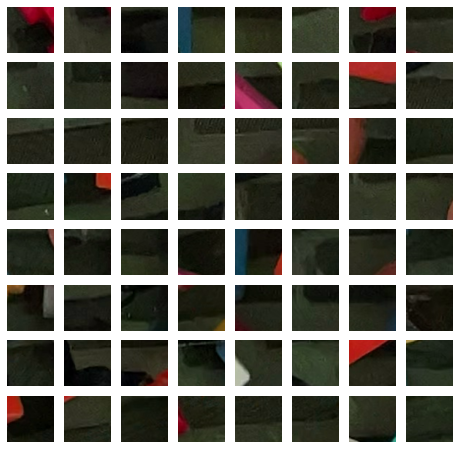

66


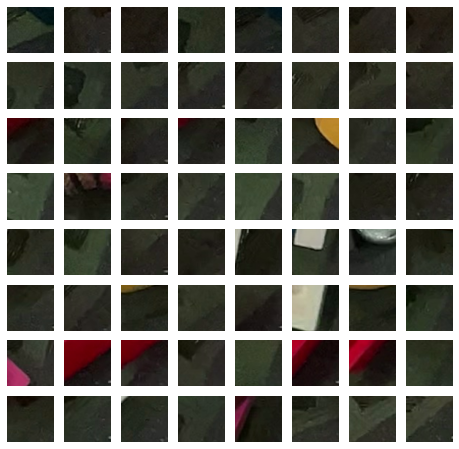

67


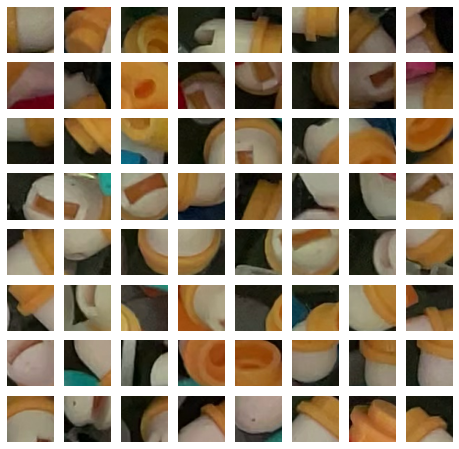

68


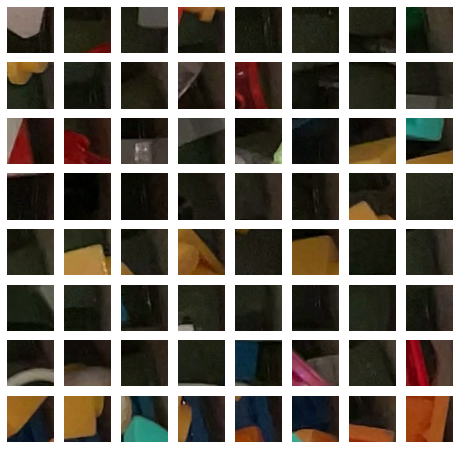

69


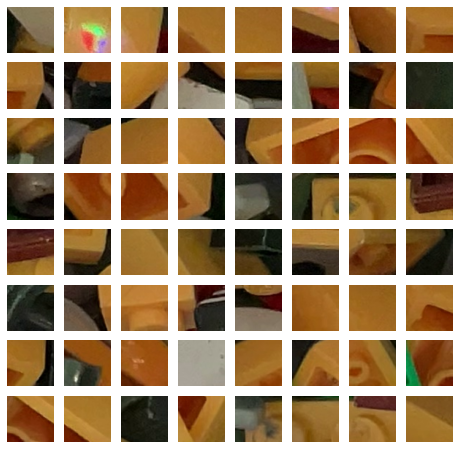

70


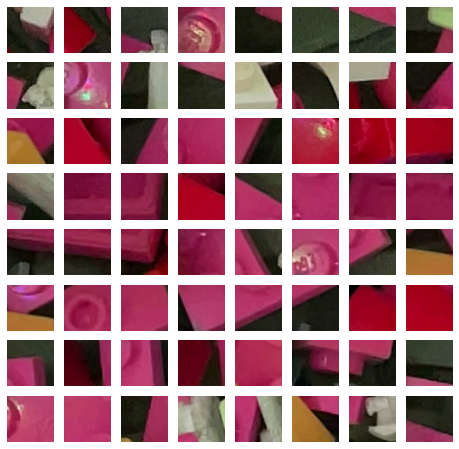

71


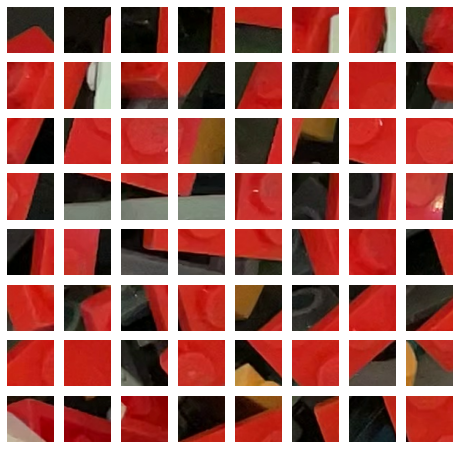

72


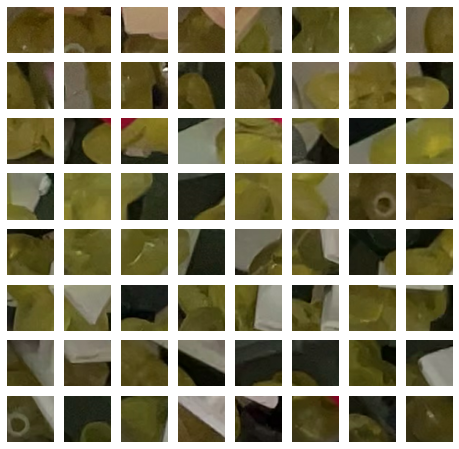

73


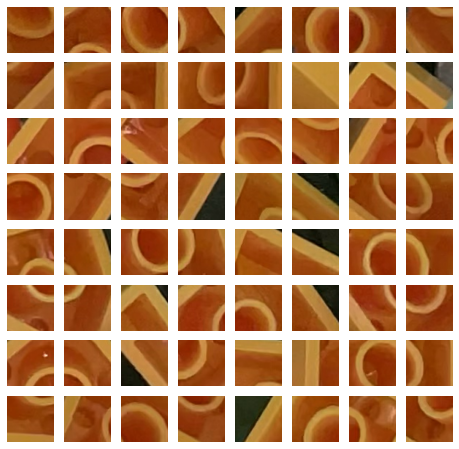

74


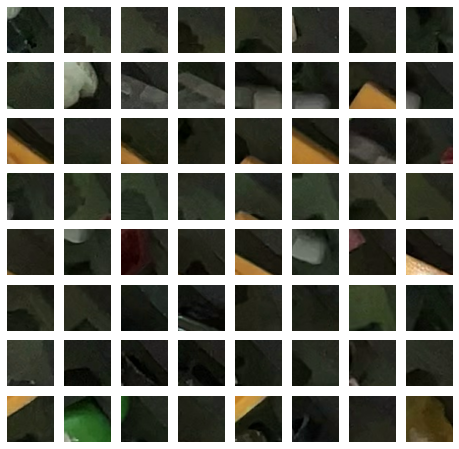

75


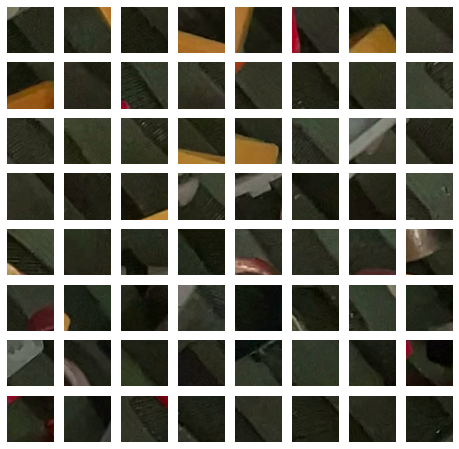

76


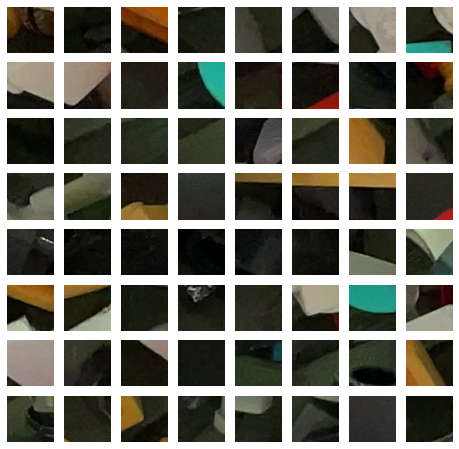

77


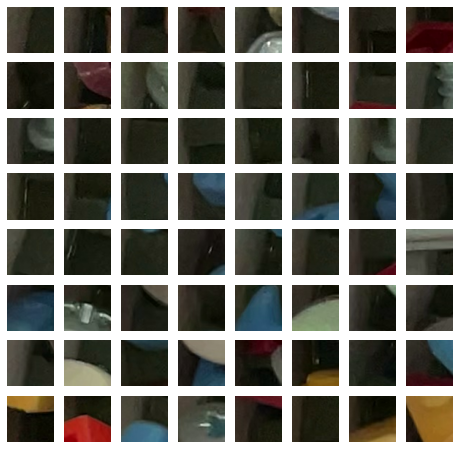

78


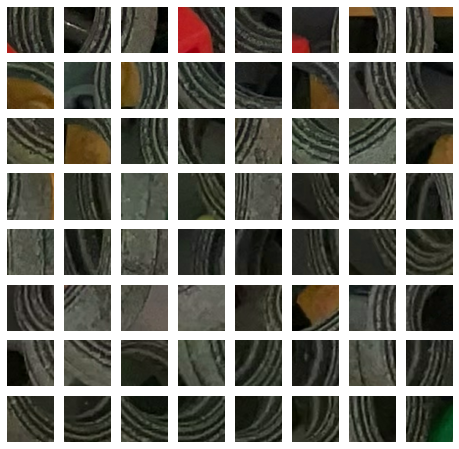

79


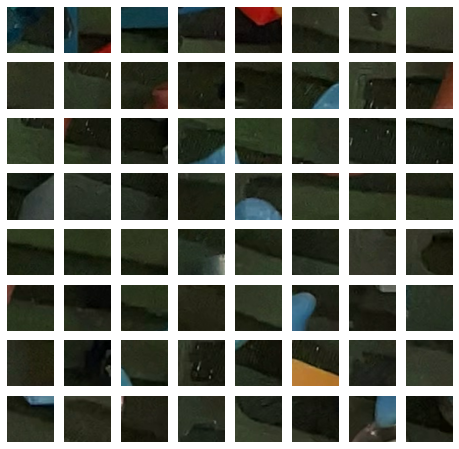

80


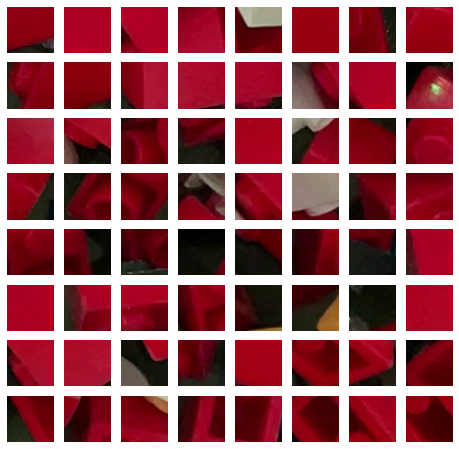

81


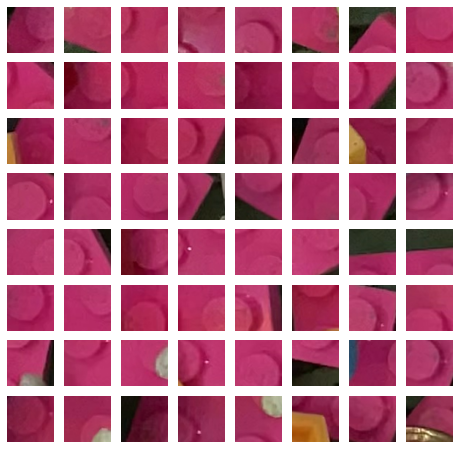

82


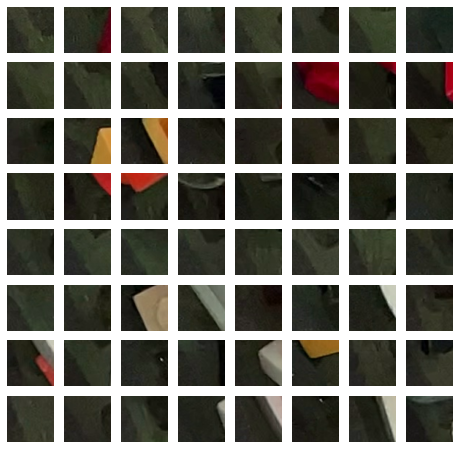

83


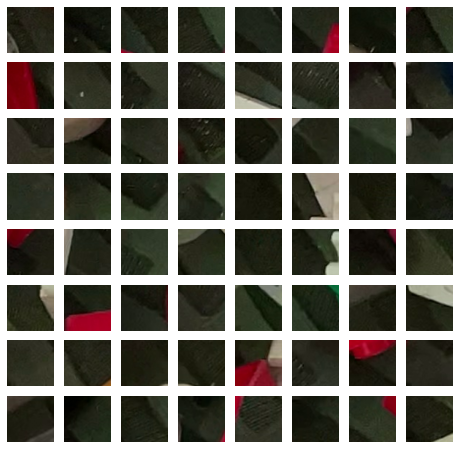

84


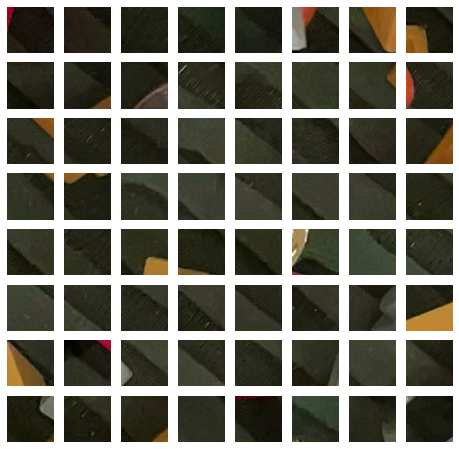

85


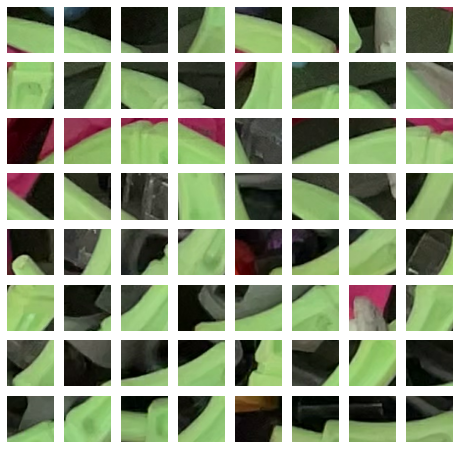

86


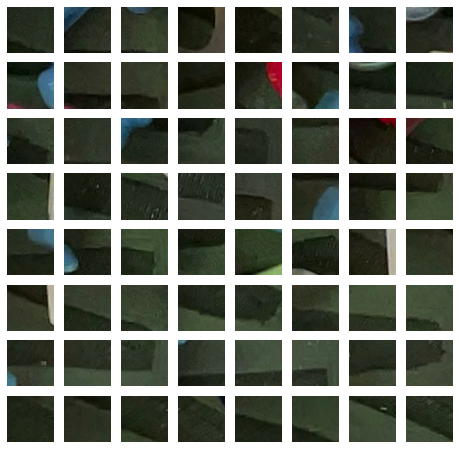

87


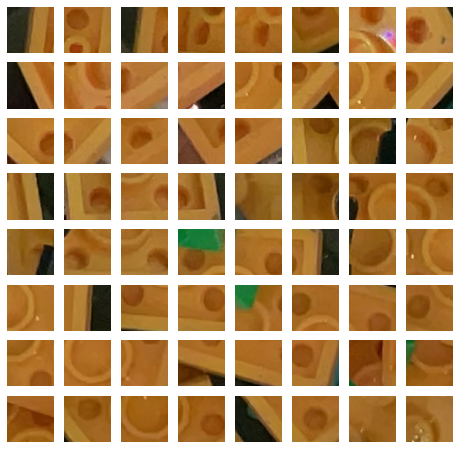

88


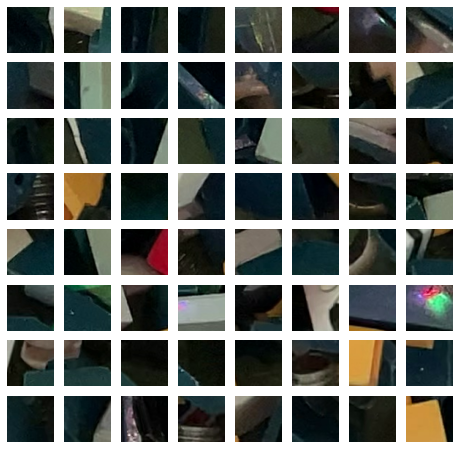

89


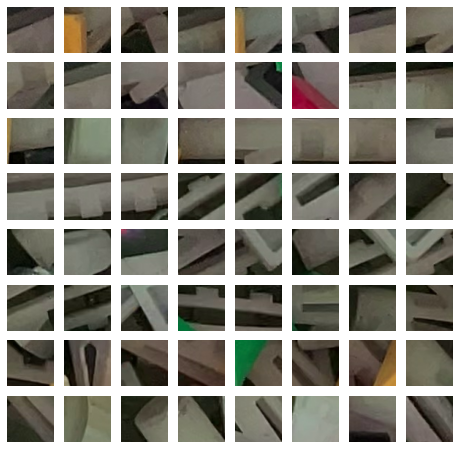

90


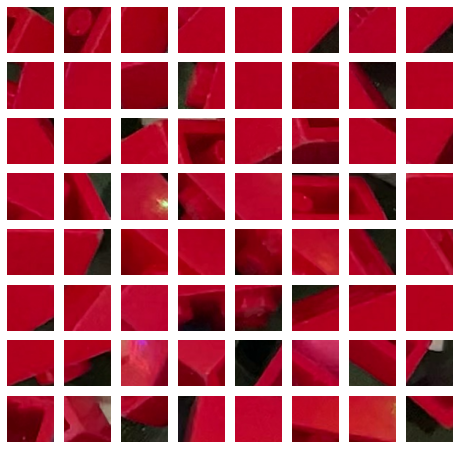

91


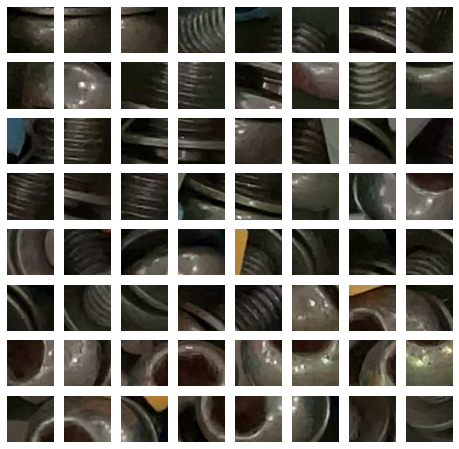

92


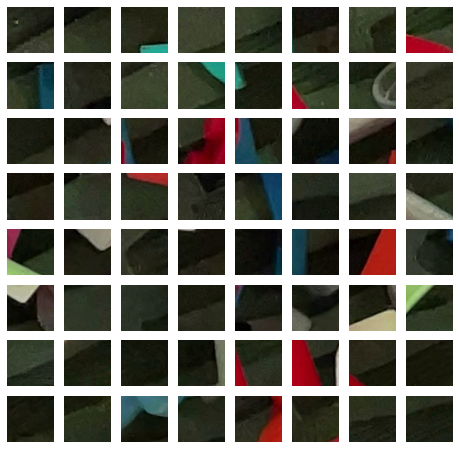

93


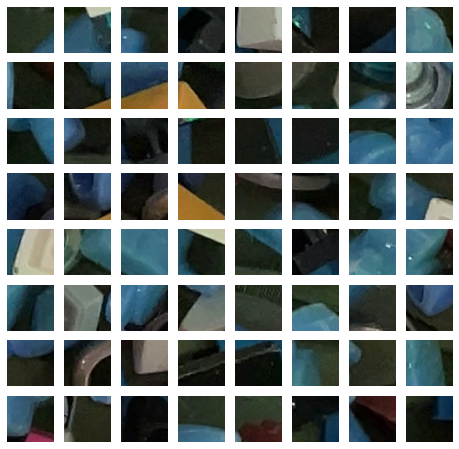

94


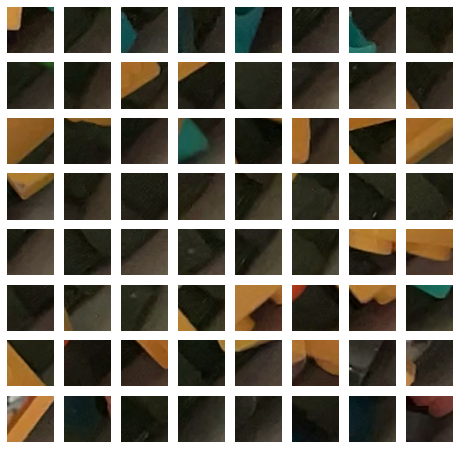

95


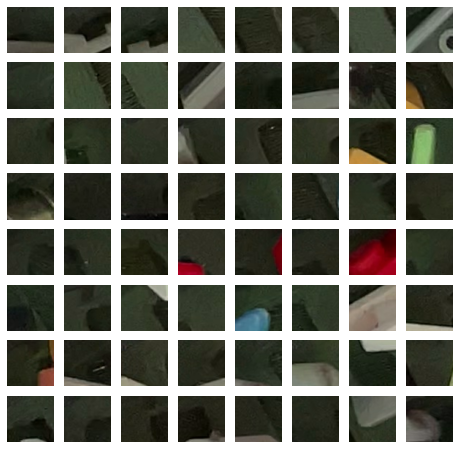

96


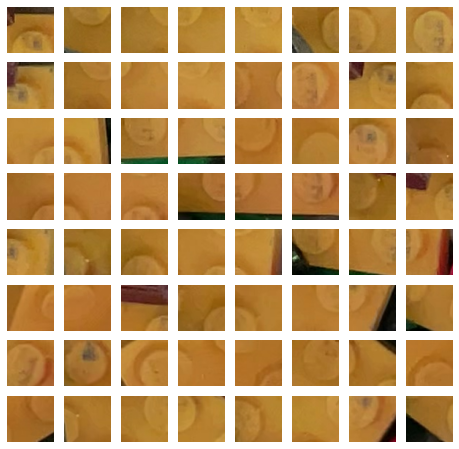

97


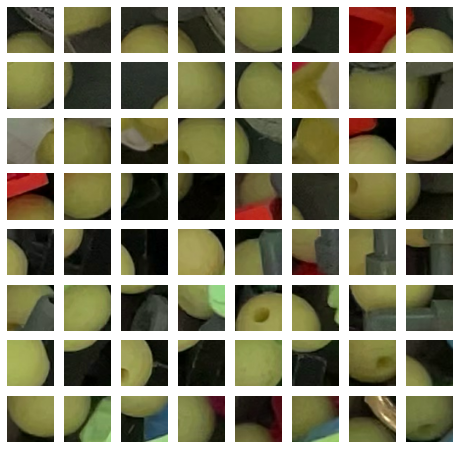

98


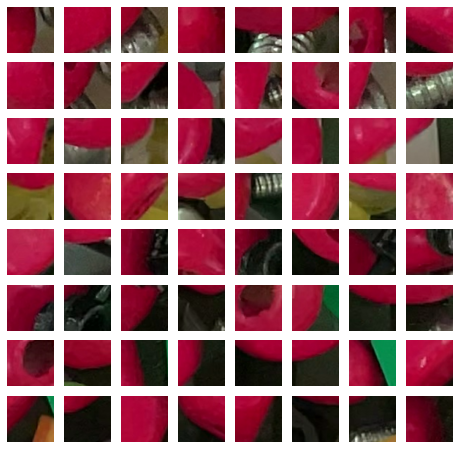

99


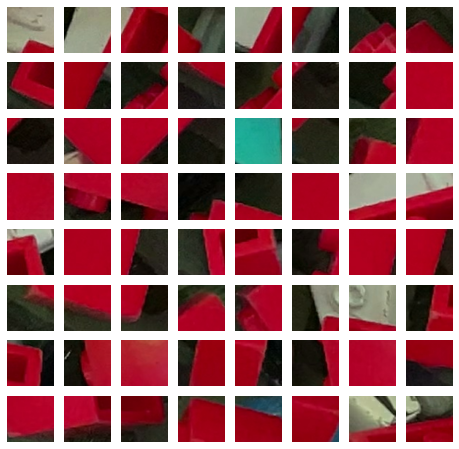

In [10]:
# 

for j in range(n_clusters):
  print(j)
  indexer.show_patches(imgs[j==clusters][:64])

# Summary

I will leave it here for now. It's clear that the model is able to distinguish between different parts!

I have done some semi-successful attempts at filtering out the bad clusters, where the model picks up something in the background and duplicates, but it's still in development.

